In [1]:
import numpy as np
import scanpy as sc
import matplotlib.pyplot as plt
from numpy.random import default_rng
import squidpy as sq
import pandas as pd
import anndata as ad
from pathlib import Path
from jax.config import config
import seaborn as sns
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from joblib import delayed, Parallel
from anndata import AnnData
import mplscience
from tqdm import tqdm
import os
import seml

mplscience.set_style()

config.update("jax_enable_x64", True)
# # sc.set_figure_params()
%load_ext autoreload
%autoreload 2
%load_ext lab_black

In [2]:
results = seml.get_results("fgw_brain", to_data_frame=True)

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

In [3]:
results

,_id,config.overwrite,config.db_collection,config.dataset,config.params.alpha,config.path_data,config.path_results,config.seed,result.time,result.file1,result.file2,result.slices
0,1,1,fgw_brain,slice1,0.3,/lustre/groups/ml01/workspace/moscot_paper/mou...,/lustre/groups/ml01/workspace/moscot_paper/ben...,936113864,31722.100209,3edf4f804ed9c4e40c7d2b4f4f45627a_0.3_1.h5ad,3edf4f804ed9c4e40c7d2b4f4f45627a_0.3_2.h5ad,"[1_1, 1_2, 1_3]"
1,2,2,fgw_brain,slice1,0.5,/lustre/groups/ml01/workspace/moscot_paper/mou...,/lustre/groups/ml01/workspace/moscot_paper/ben...,143499875,23099.879954,a90c46a33a51ed3944ab21789f51c8a9_0.5_1.h5ad,a90c46a33a51ed3944ab21789f51c8a9_0.5_2.h5ad,"[1_1, 1_2, 1_3]"
2,3,3,fgw_brain,slice2,0.3,/lustre/groups/ml01/workspace/moscot_paper/mou...,/lustre/groups/ml01/workspace/moscot_paper/ben...,202295761,22810.116002,f7bca473118193f227aaaa050cbc7641_0.3_1.h5ad,f7bca473118193f227aaaa050cbc7641_0.3_2.h5ad,"[2_1, 2_2, 2_3]"
3,4,4,fgw_brain,slice2,0.5,/lustre/groups/ml01/workspace/moscot_paper/mou...,/lustre/groups/ml01/workspace/moscot_paper/ben...,504303173,18624.017965,aecfcbad2e6ee9e42235b1600169da85_0.5_1.h5ad,aecfcbad2e6ee9e42235b1600169da85_0.5_2.h5ad,"[2_1, 2_2, 2_3]"


In [4]:
root = Path("/lustre/groups/ml01/workspace/moscot_paper/benchmarks/space/fgw_brain")

In [5]:
files = [i for i in os.listdir(root) if ".h5ad" in i]

In [6]:
files

['f7bca473118193f227aaaa050cbc7641_0.3_1.h5ad',
 'aecfcbad2e6ee9e42235b1600169da85_0.5_1.h5ad',
 'f7bca473118193f227aaaa050cbc7641_0.3_2.h5ad',
 'a90c46a33a51ed3944ab21789f51c8a9_0.5_2.h5ad',
 '3edf4f804ed9c4e40c7d2b4f4f45627a_0.3_1.h5ad',
 '3edf4f804ed9c4e40c7d2b4f4f45627a_0.3_2.h5ad',
 'aecfcbad2e6ee9e42235b1600169da85_0.5_2.h5ad',
 'a90c46a33a51ed3944ab21789f51c8a9_0.5_1.h5ad']

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


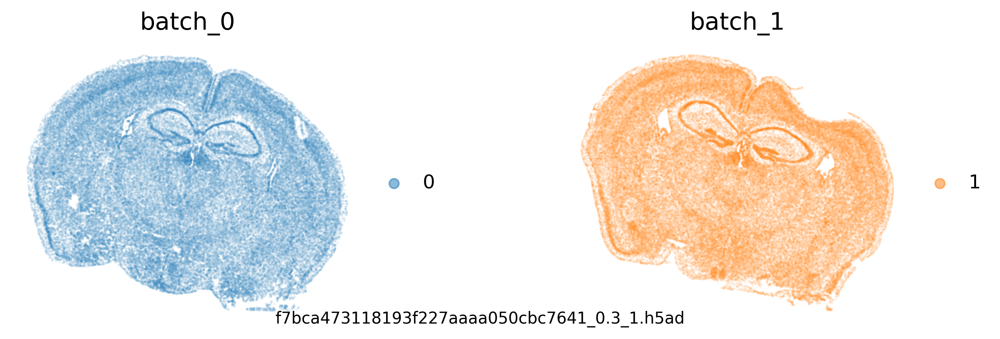

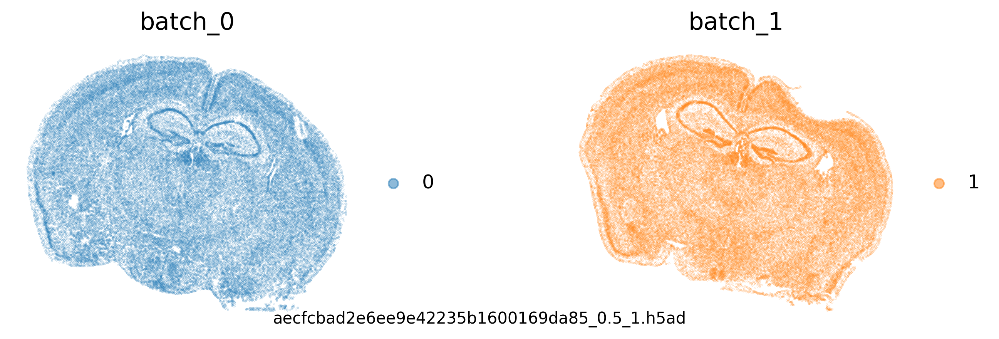

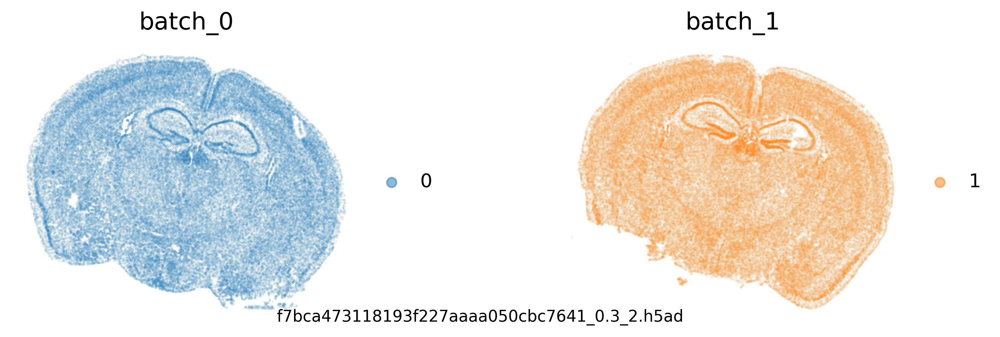

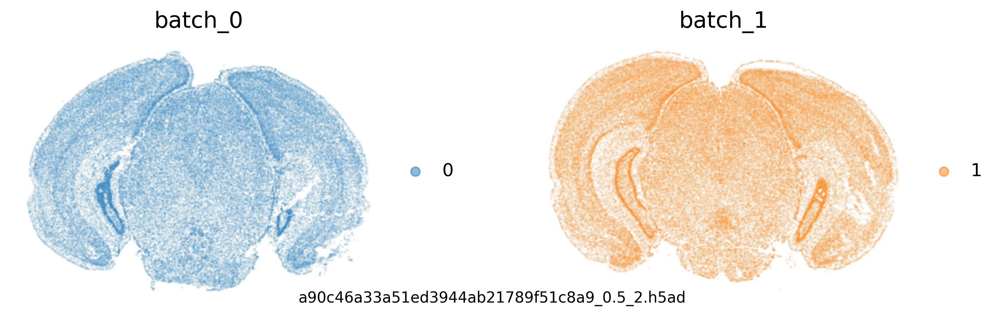

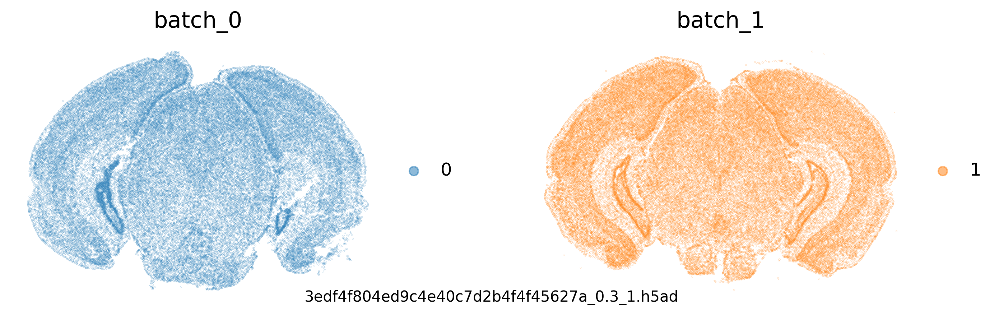

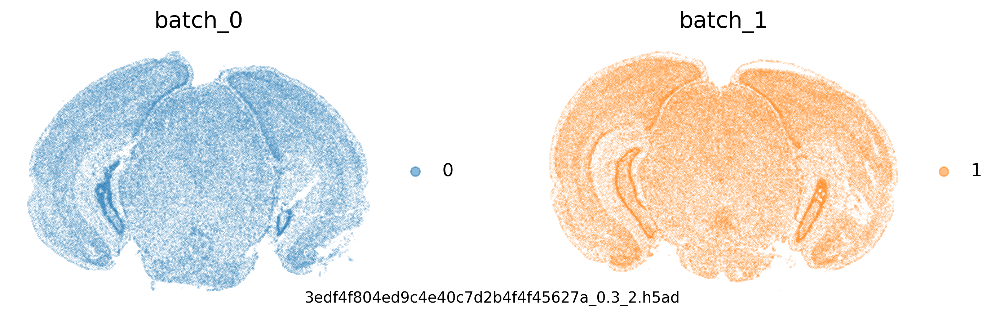

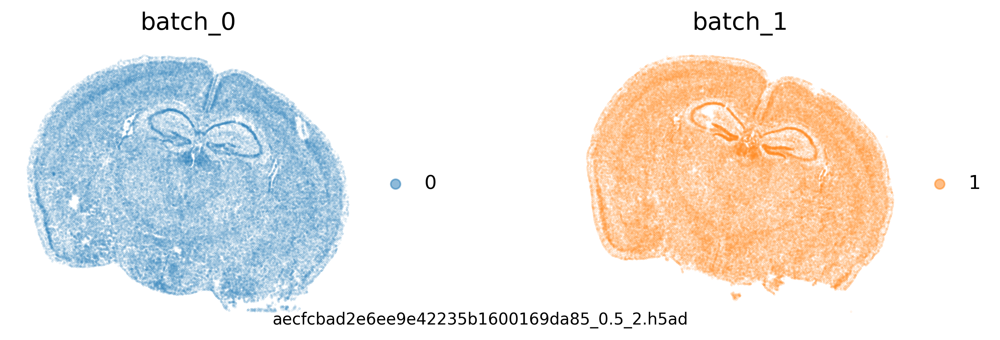

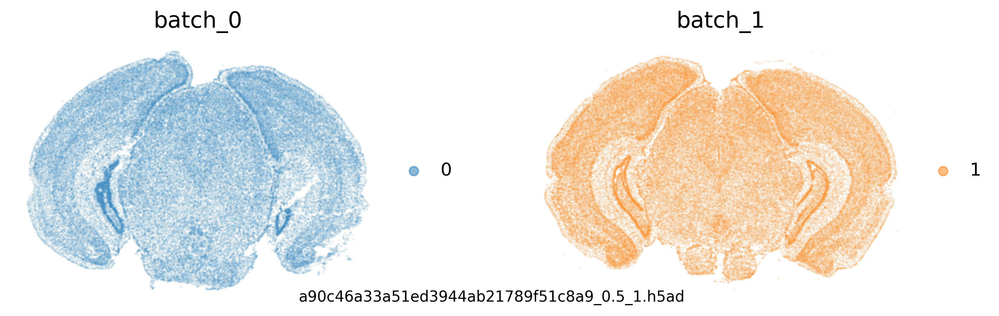

In [7]:
plt.rcParams["legend.scatterpoints"] = 1
for f in files:
    adata = sc.read(root / f)
    fig, ax = plt.subplots(1, 2, figsize=(10, 3), dpi=300)
    adata.obs["batch_final"] = adata.obs["batch"].replace(
        {adata.obs["batch"].unique()[0]: "0", adata.obs["batch"].unique()[1]: "1"}
    )
    for i, a in enumerate(ax):
        sq.pl.spatial_scatter(
            adata,
            spatial_key="spatial_norm_affine",  # "spatial_norm_warp"
            shape=None,
            color="batch_final",
            groups=[f"{i}"],
            frameon=False,
            title=[f"batch_{i}"],
            size=0.01,
            alpha=0.5,
            fig=fig,
            ax=a,
        )
    fig.text(0.5, 0.05, f, ha="center")
    plt.tight_layout()

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


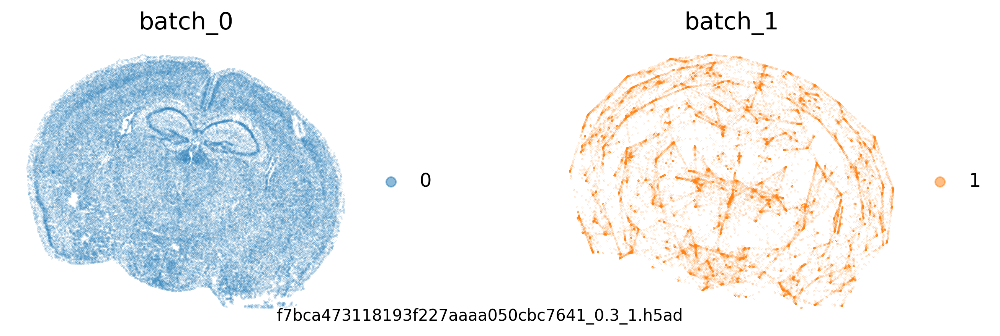

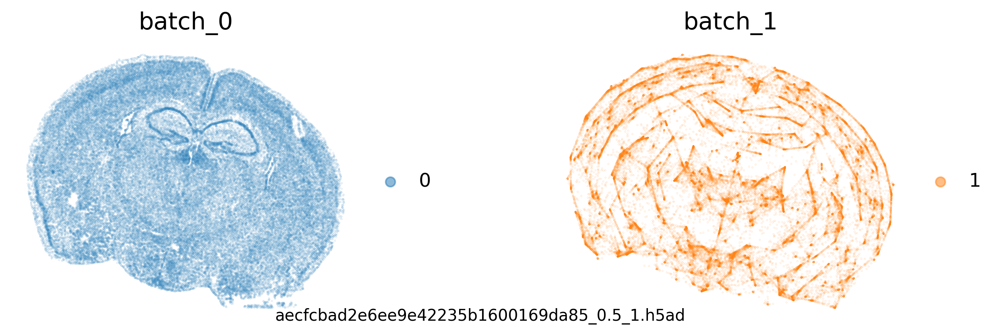

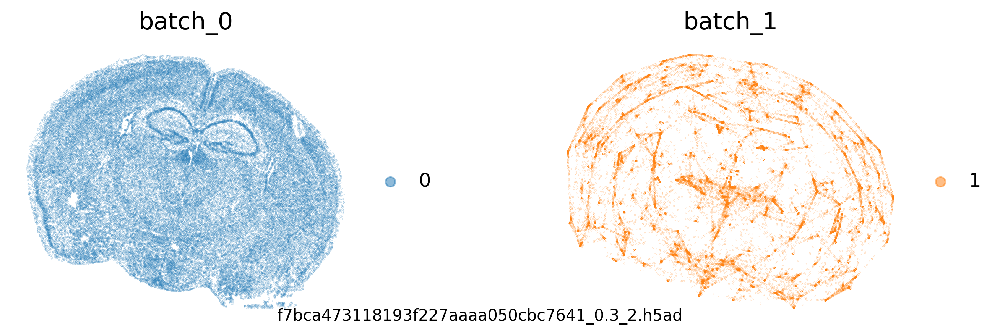

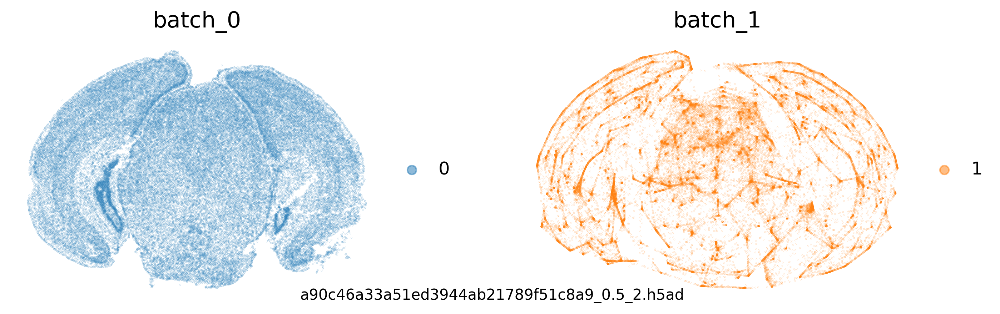

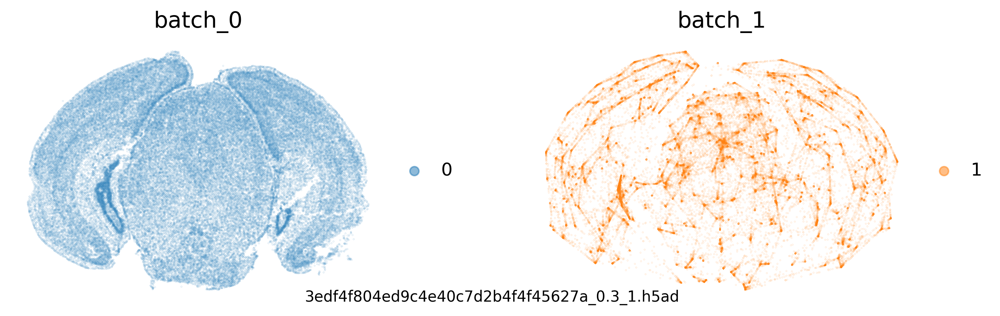

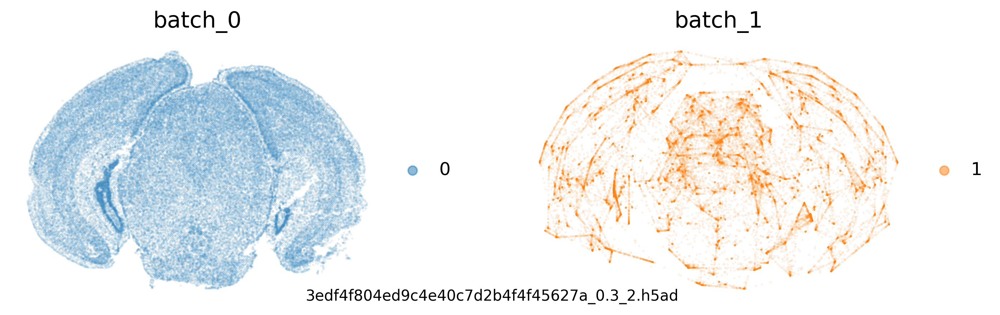

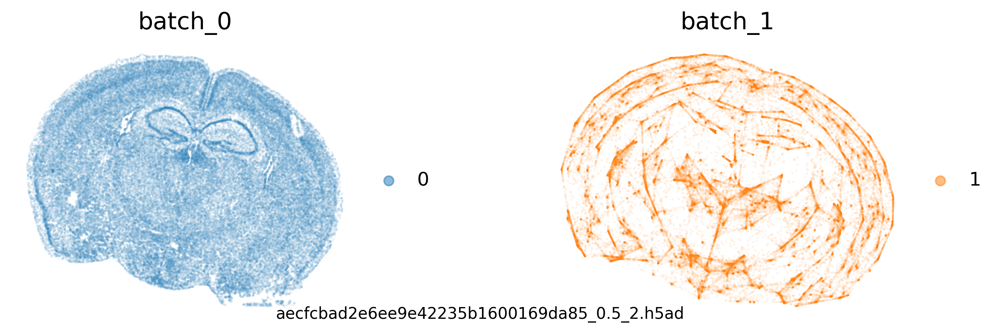

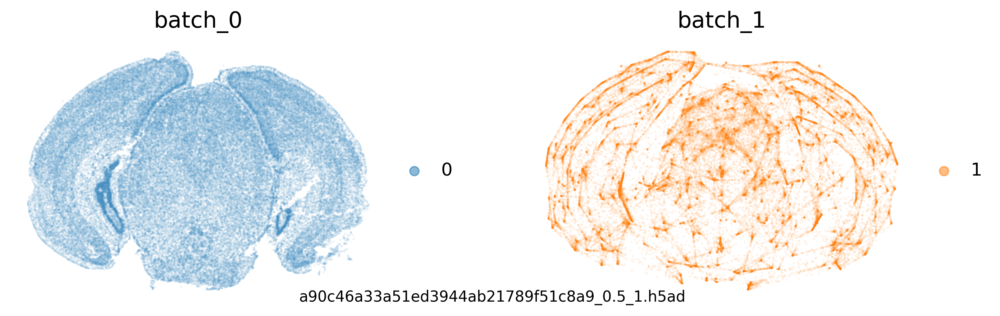

In [8]:
plt.rcParams["legend.scatterpoints"] = 1
for f in files:
    adata = sc.read(root / f)
    fig, ax = plt.subplots(1, 2, figsize=(10, 3), dpi=300)
    adata.obs["batch_final"] = adata.obs["batch"].replace(
        {adata.obs["batch"].unique()[0]: "0", adata.obs["batch"].unique()[1]: "1"}
    )
    for i, a in enumerate(ax):
        sq.pl.spatial_scatter(
            adata,
            spatial_key="spatial_norm_warp",  # "spatial_norm_warp"
            shape=None,
            color="batch_final",
            groups=[f"{i}"],
            frameon=False,
            title=[f"batch_{i}"],
            size=0.01,
            alpha=0.5,
            fig=fig,
            ax=a,
        )
    fig.text(0.5, 0.05, f, ha="center")
    plt.tight_layout()

In [16]:
adata = sc.read(root / "47078ebb0f8ea0f011f6bc040a527cb8_sink.h5ad")

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


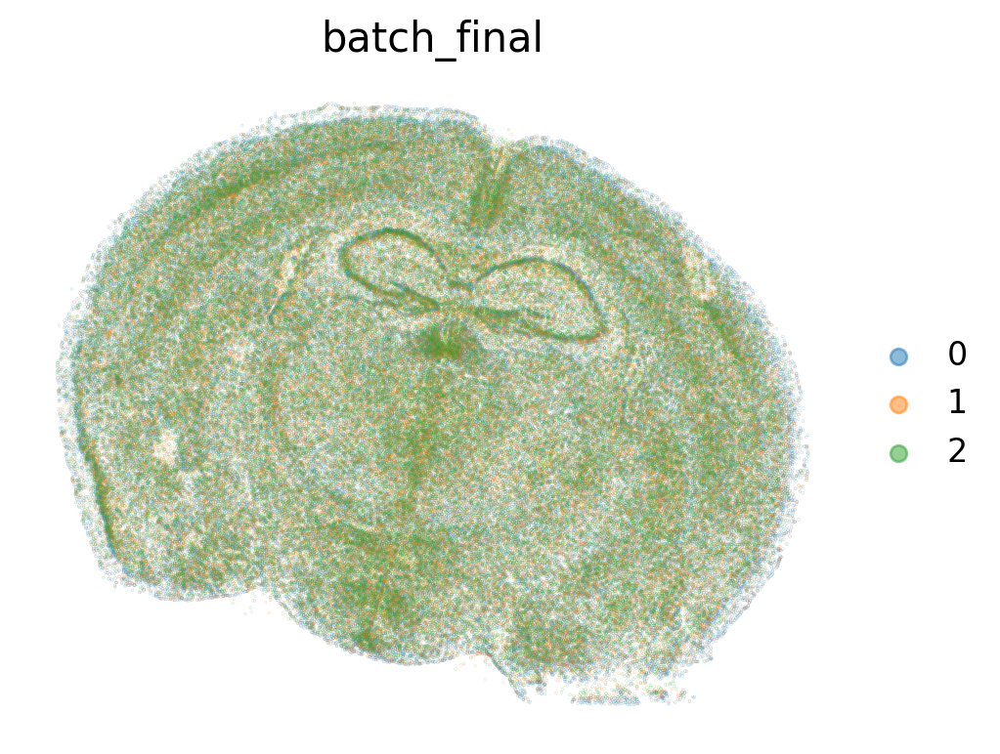

In [17]:
sq.pl.spatial_scatter(
    adata,
    spatial_key="spatial_norm_final",
    shape=None,
    color="batch_final",
    frameon=False,
    size=0.01,
    alpha=0.5,
    figsize=(5, 5),
    dpi=200,
)

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


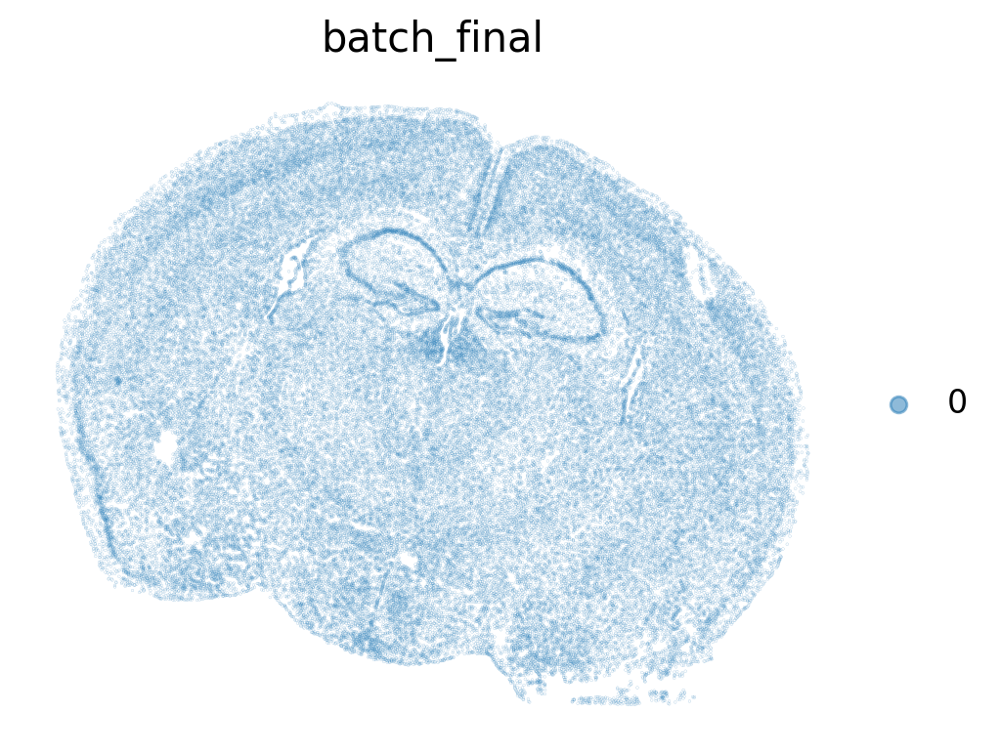

In [22]:
sq.pl.spatial_scatter(
    adata,
    spatial_key="spatial_norm_final",
    shape=None,
    color="batch_final",
    groups=["0"],
    frameon=False,
    size=0.01,
    alpha=0.5,
    figsize=(5, 5),
    dpi=200,
)

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


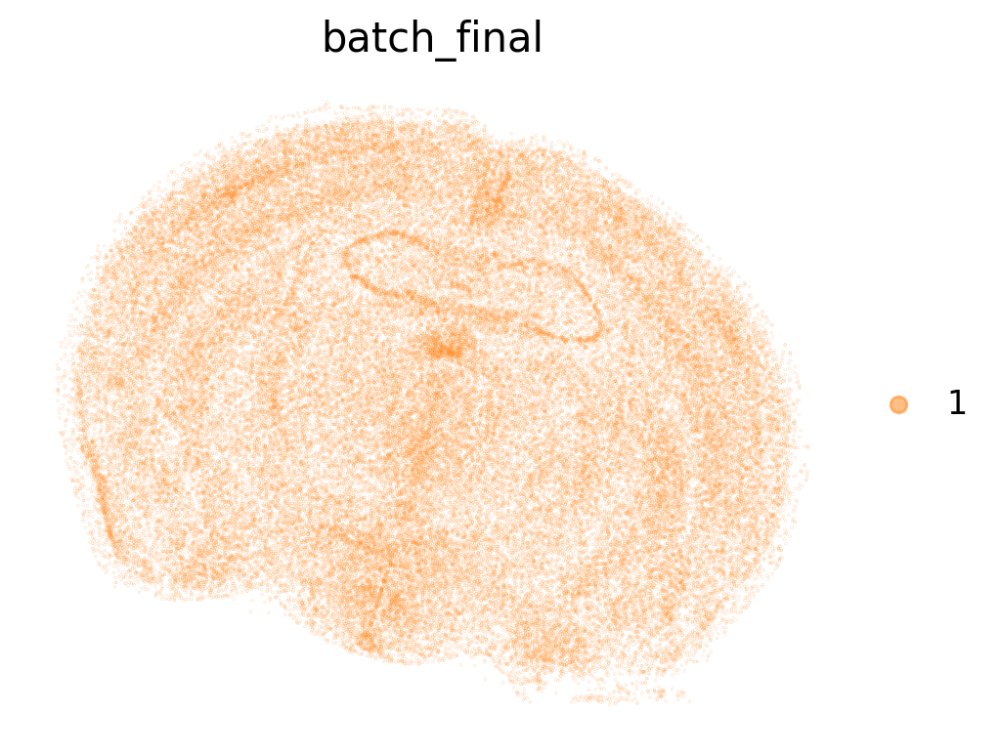

In [23]:
sq.pl.spatial_scatter(
    adata,
    spatial_key="spatial_norm_final",
    shape=None,
    color="batch_final",
    groups=["1"],
    frameon=False,
    size=0.01,
    alpha=0.5,
    figsize=(5, 5),
    dpi=200,
)

In [13]:
adata = sc.read(root / "7bab87ad3c83e7f0018c2c8884201478_sink.h5ad")

In [18]:
adata.write(root / "temp_adata.h5ad")

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


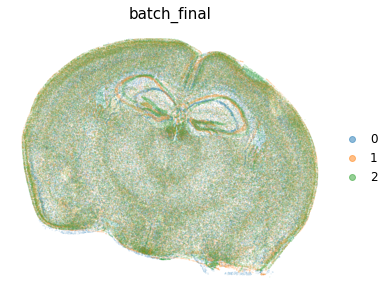

In [14]:
sq.pl.spatial_scatter(
    adata,
    spatial_key="spatial_norm_final",
    shape=None,
    color="batch_final",
    frameon=False,
    size=0.01,
    alpha=0.5,
)

In [4]:
arr = adata.obsm["spatial_norm_final"].copy()
xv = np.linspace(arr[:, 0].min(), arr[:, 0].max(), 10)
yv = np.linspace(arr[:, 1].min(), arr[:, 1].max(), 10)

In [5]:
adata.X = adata.X.A.copy()

In [8]:
from itertools import tee, product


def pairwise(iterable):
    # pairwise('ABCDEFG') --> AB BC CD DE EF FG
    a, b = tee(iterable)
    next(b, None)
    return zip(a, b)


def aggregate(x_vals, y_vals, arr, adata):
    x_min, x_max = x_vals
    y_min, y_max = y_vals
    cond = (
        (x_min < arr[:, 0])
        & (arr[:, 0] <= x_max)
        & (y_min < arr[:, 1])
        & (arr[:, 1] <= y_max)
    )
    x_mean = np.mean([x_min, x_max])
    y_mean = np.mean([y_min, y_max])
    if sum(cond):
        sum_coords = sum(cond)
        coords = np.array([x_mean, y_mean])
        means = np.array(adata[cond].X).mean(0)
        var = np.array(adata[cond].X).var(0)
        medians = np.median(np.array(adata[cond].X), 0)
        batches = adata[cond].obs.batch_final.values
        out = {
            "idx": sum_coords,
            "coords": coords,
            "means": means,
            "var": var,
            "medians": medians,
            "batches": batches,
        }
        return out

In [9]:
res = Parallel(n_jobs=20)(
    delayed(aggregate)(x_val, y_val, arr, adata)
    for x_val, y_val in product(pairwise(xv), pairwise(yv))
)

In [10]:
# res = []
# for x_val, y_val in product(pairwise(xv), pairwise(yv)):
#     out = aggregate(x_val, y_val, arr, adata)
#     res.append(out)

In [10]:
spatial = np.vstack([i["coords"] for i in res if i is not None])
means = np.vstack([i["means"] for i in res if i is not None])
medians = np.vstack([i["medians"] for i in res if i is not None])
var = np.vstack([i["var"] for i in res if i is not None])
cv = np.sqrt(var) / means

/tmp/ipykernel_226233/2124460658.py:5: RuntimeWarning: invalid value encountered in true_divide
  cv = np.sqrt(var) / means


In [11]:
batch_count = [i["batches"] for i in res if i is not None]
batch_sum = [len(i.categories) for i in batch_count]

In [13]:
adata_grid = AnnData(means, obsm={"spatial": spatial})
adata_grid.var_names = adata.var_names
adata_grid.obs["sum_cells"] = np.array([i["idx"] for i in res if i is not None])
adata_grid.obs["sum_batch"] = batch_sum
adata_grid.obs["batches"] = batch_count

In [14]:
adata_grid.layers["X_var"] = var
adata_grid.layers["X_median"] = medians
adata_grid.layers["X_cv"] = medians

<AxesSubplot: xlabel='sum_cells', ylabel='Count'>

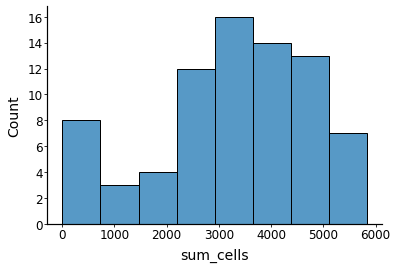

In [15]:
sns.histplot(adata_grid.obs["sum_cells"])

<AxesSubplot: xlabel='sum_batch', ylabel='Count'>

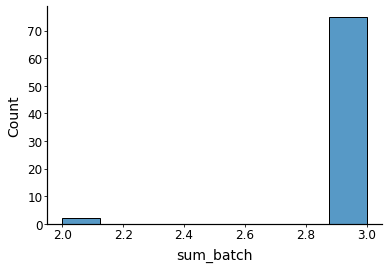

In [16]:
sns.histplot(adata_grid.obs["sum_batch"])

In [22]:
cond = (adata_grid.obs["sum_batch"] > 2) & (adata_grid.obs["sum_cells"] > 2)
adata_final = adata_grid[cond].copy()
adata_final

AnnData object with n_obs × n_vars = 75 × 483
    obs: 'sum_cells', 'sum_batch', 'batches'
    obsm: 'spatial'
    layers: 'X_var', 'X_median', 'X_cv'

In [23]:
batch_list = adata_final.obs["batches"].map(lambda x: x.value_counts().values / len(x))
batch_df = pd.DataFrame.from_dict(dict(zip(batch_list.index, batch_list.values))).T
adata_final.obs.drop(columns="batches", inplace=True)
batch_df

,0,1,2
0,0.166667,0.416667,0.416667
1,0.221235,0.400000,0.378765
2,0.256783,0.384205,0.359012
3,0.280949,0.356167,0.362883
4,0.282596,0.369325,0.348079
...,...,...,...
72,0.240928,0.383671,0.375400
73,0.273035,0.376542,0.350423
74,0.271154,0.382051,0.346795
75,0.251223,0.378467,0.370310


In [24]:
for c in batch_df.columns:
    adata_final.obs[f"batch_{c}"] = batch_df[c].values

In [25]:
from scipy.stats import entropy

adata_final.obs["batch_entropy"] = adata_final.obs[
    [f"batch_{c}" for c in [0, 1, 2]]
].apply(entropy, axis=1)
adata_final.obs

,sum_cells,sum_batch,batch_0,batch_1,batch_2,batch_entropy
0,12,3,0.166667,0.416667,0.416667,1.028184
1,2025,3,0.221235,0.400000,0.378765,1.067976
2,4128,3,0.256783,0.384205,0.359012,1.084397
3,4467,3,0.280949,0.356167,0.362883,1.092224
4,3436,3,0.282596,0.369325,0.348079,1.092340
...,...,...,...,...,...,...
72,3748,3,0.240928,0.383671,0.375400,1.078251
73,4135,3,0.273035,0.376542,0.350423,1.089679
74,3120,3,0.271154,0.382051,0.346795,1.088748
75,2452,3,0.251223,0.378467,0.370310,1.082643


In [67]:
z = 2
adata_final.layers["interval_min"] = adata_final.X - z * np.sqrt(
    adata_final.layers["X_var"]
)
adata_final.layers["interval_max"] = adata_final.X + z * np.sqrt(
    adata_final.layers["X_var"]
)

In [117]:
from itertools import combinations

d = {}
for i, (g1, g2) in tqdm(enumerate(combinations(adata_final.var_names[:20], 2))):

    if g1 == g2:
        continue
    cond1 = (
        adata_final[:, g1].layers["interval_min"]
        < adata_final[:, g2].layers["interval_min"]
    ) | (
        adata_final[:, g1].layers["interval_max"]
        > adata_final[:, g2].layers["interval_max"]
    )
    cond2 = (
        adata_final[:, g2].layers["interval_min"]
        < adata_final[:, g1].layers["interval_min"]
    ) | (
        adata_final[:, g2].layers["interval_max"]
        > adata_final[:, g1].layers["interval_max"]
    )
    idx1 = np.where(cond1)[0]
    idx2 = np.where(cond2)[0]
    arr = np.full(shape=(adata_final.shape[0],), fill_value=np.nan)
    if len(idx1) > 1:
        arr[idx1] = np.take_along_axis(adata_final[:, g1].X.flatten(), idx1, axis=0)
    if len(idx2) > 1:
        arr[idx2] = -np.take_along_axis(adata_final[:, g2].X.flatten(), idx2, axis=0)
    d[f"{g1}_{g2}"] = arr

190it [00:00, 450.26it/s]


In [126]:
pd.DataFrame(d)

,Oxgr1_Htr1a,Oxgr1_Htr1b,Oxgr1_Htr1d,Oxgr1_Htr1f,Oxgr1_Htr2a,Oxgr1_Htr2b,Oxgr1_Htr2c,Oxgr1_Htr4,Oxgr1_Htr5a,Oxgr1_Htr5b,...,Adora2b_Adora3,Adora2b_Adgra1,Adora2b_Adgra2,Adora2b_Adgra3,Adora3_Adgra1,Adora3_Adgra2,Adora3_Adgra3,Adgra1_Adgra2,Adgra1_Adgra3,Adgra2_Adgra3
0,-0.063386,-0.037512,NaN,NaN,-0.037512,NaN,NaN,NaN,-0.164919,NaN,...,NaN,-0.135370,-0.492907,-0.457800,-0.135370,-0.492907,-0.457800,-0.492907,-0.457800,0.492907
1,-0.128314,-0.130981,0.013534,-0.081011,-0.118375,0.013534,-0.034935,-0.035269,-0.230412,0.013534,...,0.045482,-0.413525,-0.132461,-0.211843,-0.413525,-0.132461,-0.211843,0.413525,0.413525,-0.211843
2,-0.132043,-0.163819,0.019746,-0.152089,-0.125689,0.019746,-0.096216,-0.055710,-0.214561,0.019746,...,0.043234,-0.642043,-0.116417,-0.216264,-0.642043,-0.116417,-0.216264,0.642043,0.642043,-0.216264
3,-0.137658,-0.198339,0.019555,-0.115792,-0.118231,0.019555,-0.167025,-0.073480,-0.198756,-0.036792,...,0.044385,-0.669201,-0.109821,-0.201639,-0.669201,-0.109821,-0.201639,0.669201,0.669201,-0.201639
4,-0.122876,-0.136319,0.015059,-0.100038,-0.190126,0.015059,-0.178012,-0.067632,-0.178369,-0.035670,...,0.061942,-0.687532,-0.144915,-0.212370,-0.687532,-0.144915,-0.212370,0.687532,0.687532,-0.212370
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70,-0.125402,-0.153813,0.018313,-0.148744,-0.124891,0.018313,-0.086620,-0.040449,-0.201453,0.018313,...,0.049532,-0.615508,-0.124543,-0.229793,-0.615508,-0.124543,-0.229793,0.615508,0.615508,-0.229793
71,-0.135990,-0.198610,0.015775,-0.107306,-0.112678,0.015775,-0.219735,-0.061888,-0.181531,-0.027492,...,0.054296,-0.668887,-0.114563,-0.205252,-0.668887,-0.114563,-0.205252,0.668887,0.668887,-0.205252
72,-0.107164,-0.146256,0.015633,-0.109916,-0.190070,0.015633,-0.231793,-0.067964,-0.168843,-0.028616,...,0.064167,-0.697201,-0.123901,-0.221722,-0.697201,-0.123901,-0.221722,0.697201,0.697201,-0.221722
73,-0.141798,-0.098406,0.017828,-0.070775,-0.165407,0.017828,-0.169758,-0.074309,-0.168645,0.017828,...,0.074166,-0.556043,-0.139017,-0.236607,-0.556043,-0.139017,-0.236607,0.556043,0.556043,-0.236607


In [129]:
feat = "Adora2b_Adora3"
adata_final.obs[feat] = pd.DataFrame(d)[feat].values

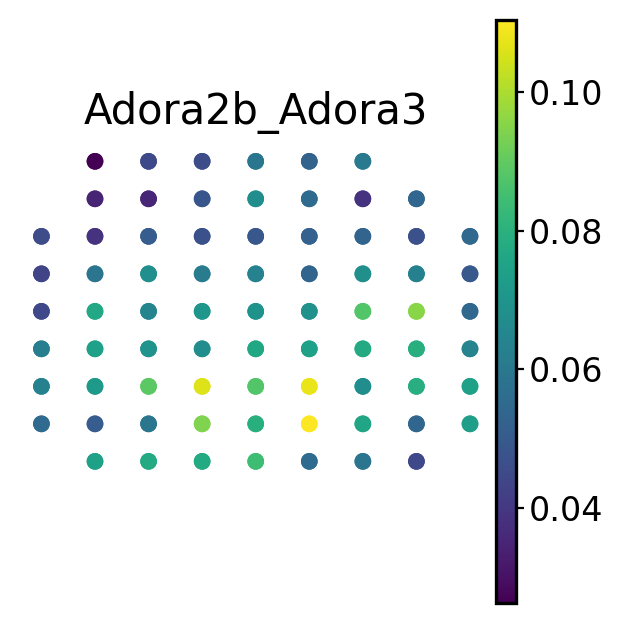

In [130]:
sq.pl.spatial_scatter(
    adata_final,
    shape=None,
    color=feat,
    size=100,
    frameon=False,
    figsize=(3, 3),
    ncols=3,
    dpi=200,
)

In [113]:
adata_final

AnnData object with n_obs × n_vars = 75 × 483
    obs: 'sum_cells', 'sum_batch', 'batch_0', 'batch_1', 'batch_2', 'batch_entropy'
    obsm: 'spatial'
    layers: 'X_var', 'X_median', 'X_cv', 'interval_min', 'interval_max'

In [61]:
a = np.array([0, 1, 2, 4])
b = np.array([1, 3, 1, 2])
idx = np.where(a > b)
idx[0]

array([2, 3])

In [21]:
adata_final = sc.read(root / "adata_full_FGW_RUN_ALIGNED_MINMAX_FINAL.h5ad")

In [26]:
from scipy.stats import spearmanr

d = {}
for g in adata_final.var_names:
    d[g], _ = spearmanr(
        adata_final[:, g].layers["X_cv"].flatten(), adata_final[:, g].X.flatten()
    )

/home/icb/giovanni.palla/miniconda3/envs/moscot/lib/python3.9/site-packages/scipy/stats/_stats_py.py:4881: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(warn_msg))


In [27]:
pd.Series(d).dropna().sort_values(ascending=False)

Adgrl1    0.993165
Celsr2    0.992987
Adgrb3    0.992596
Cx3cl1    0.992034
Lmtk2     0.988321
            ...   
Gramd3    0.198680
Gpr61     0.193310
Nrp2      0.187940
Crhr1     0.182571
Epha5     0.166461
Length: 107, dtype: float64

In [28]:
pd.Series(
    {k: v for k, v in zip(adata_final.var_names, adata_final.layers["X_cv"].mean(0))}
).sort_values()

Oxgr1      0.000000
F2rl3      0.000000
F2rl2      0.000000
F2rl1      0.000000
F2r        0.000000
             ...   
Gabbr2     1.436845
Cspg5      1.576224
Slc17a7    1.636698
Cx3cl1     1.676245
Gabbr1     2.334293
Length: 483, dtype: float32

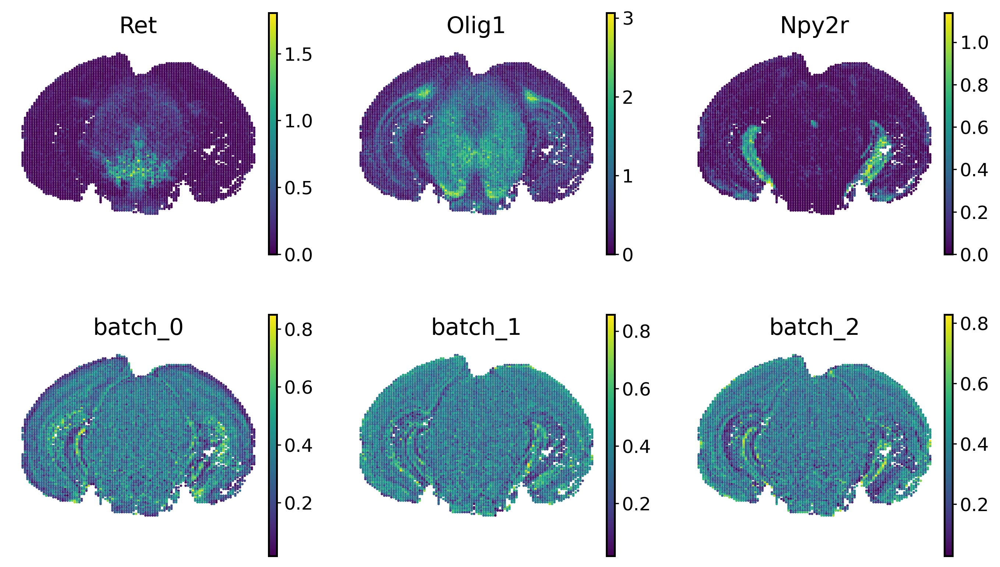

In [155]:
genes = ["Ret", "Olig1", "Npy2r"]
batches = ["batch_0", "batch_1", "batch_2"]
sq.pl.spatial_scatter(
    adata_final,
    shape=None,
    color=genes + batches,
    size=1,
    frameon=False,
    figsize=(3, 3),
    title=genes + batches,
    ncols=3,
    dpi=300,
)

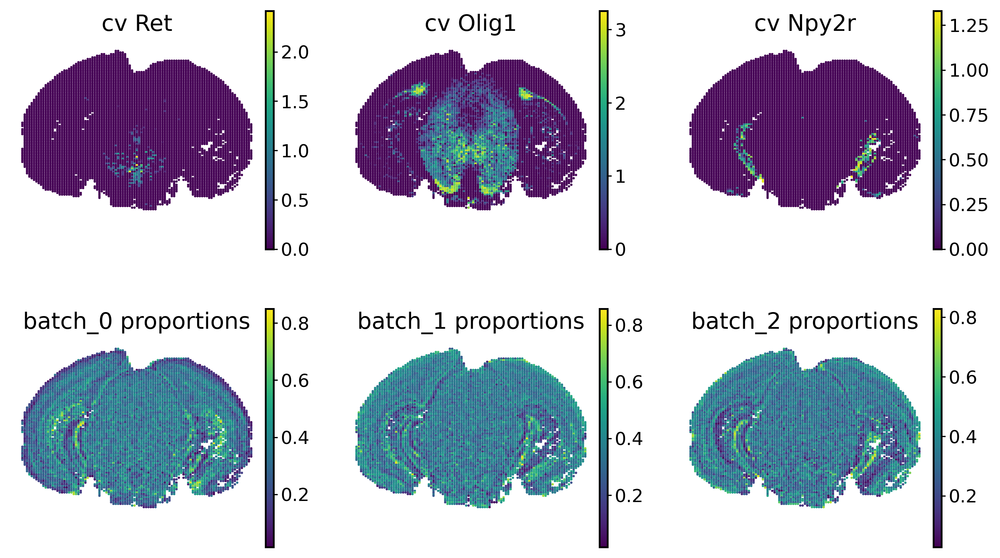

In [183]:
genes = ["Ret", "Olig1", "Npy2r"]
batches = ["batch_0", "batch_1", "batch_2"]
sq.pl.spatial_scatter(
    adata_final,
    shape=None,
    color=genes + batches,
    size=1,
    layer="X_cv",
    frameon=False,
    figsize=(3, 3),
    title=[f"cv {g}" for g in genes] + [f"{b} proportions" for b in batches],
    ncols=3,
    dpi=300,
)

In [181]:
adata_final

AnnData object with n_obs × n_vars = 7180 × 483
    obs: 'sum_cells', 'sum_batch', 'batch_0', 'batch_1', 'batch_2', 'batch_entropy'
    obsm: 'spatial'
    layers: 'X_var', 'X_median', 'X_cv'

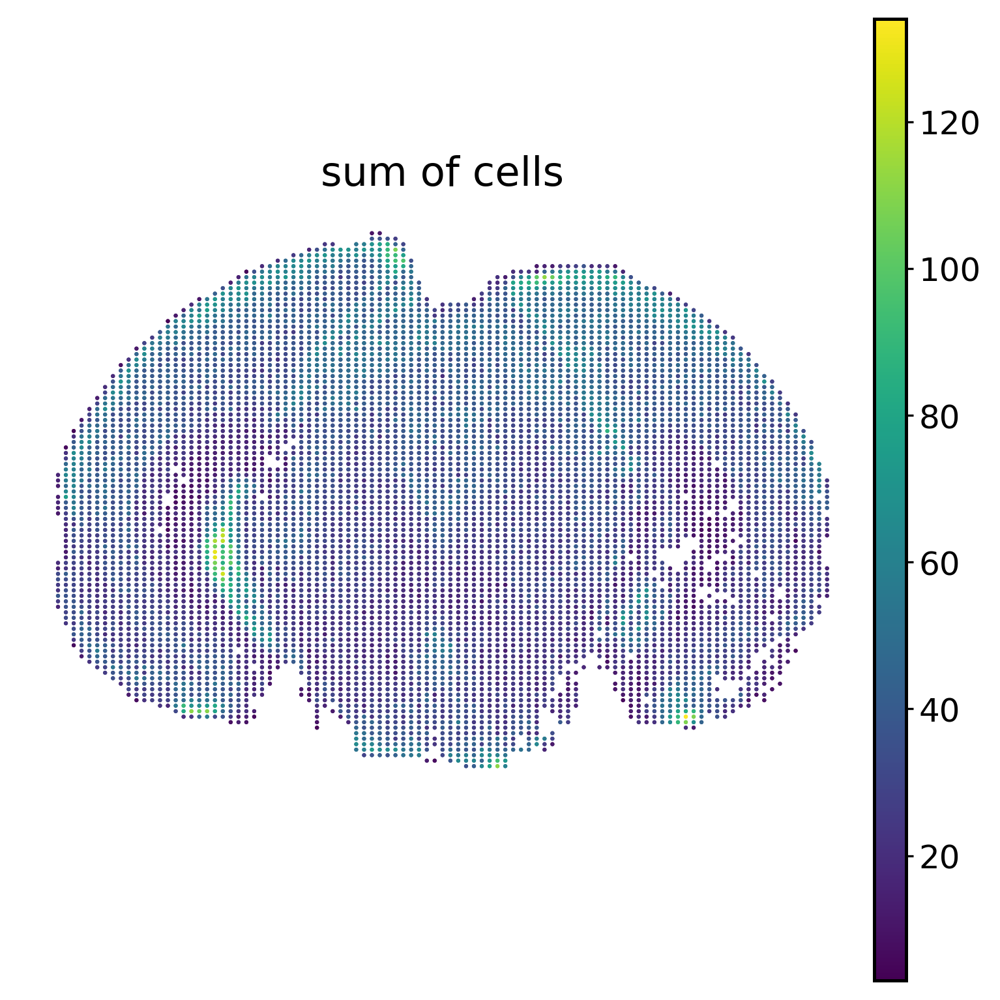

In [188]:
sq.pl.spatial_scatter(
    adata_final,
    shape=None,
    color=["sum_cells"],
    size=1,
    frameon=False,
    figsize=(5, 5),
    title="sum of cells",
    dpi=300,
)

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


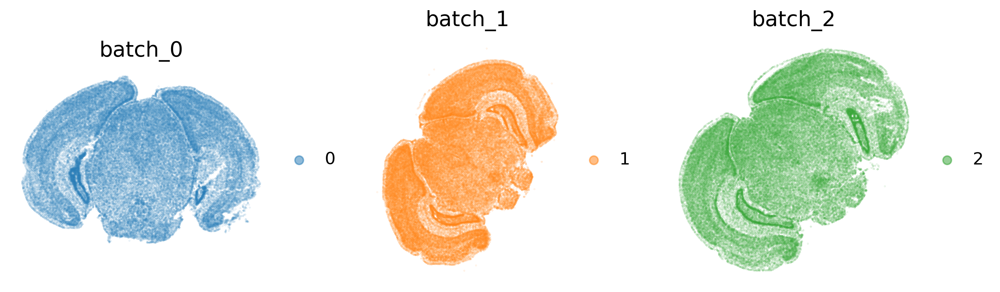

In [177]:
plt.rcParams["legend.scatterpoints"] = 1
fig, ax = plt.subplots(1, 3, figsize=(10, 3), dpi=300)

for i, a in enumerate(ax):
    sq.pl.spatial_scatter(
        adata,
        spatial_key="spatial",
        shape=None,
        color="batch_final",
        groups=[f"{i}"],
        frameon=False,
        title=[f"batch_{i}"],
        size=0.01,
        alpha=0.5,
        fig=fig,
        ax=a,
    )
plt.tight_layout()

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(
/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


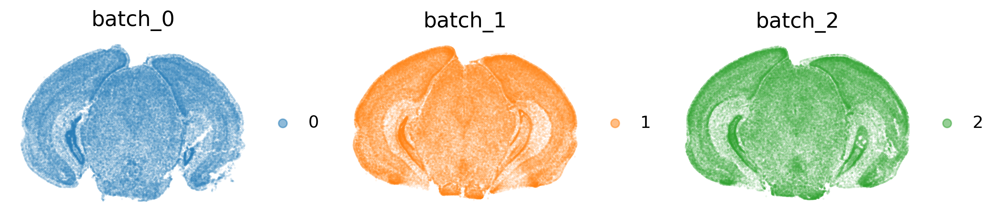

In [176]:
plt.rcParams["legend.scatterpoints"] = 1
fig, ax = plt.subplots(1, 3, figsize=(10, 3), dpi=300)

for i, a in enumerate(ax):
    sq.pl.spatial_scatter(
        adata,
        spatial_key="spatial_norm_final",
        shape=None,
        color="batch_final",
        groups=[f"{i}"],
        frameon=False,
        title=[f"batch_{i}"],
        size=0.01,
        alpha=0.5,
        fig=fig,
        ax=a,
    )
plt.tight_layout()

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


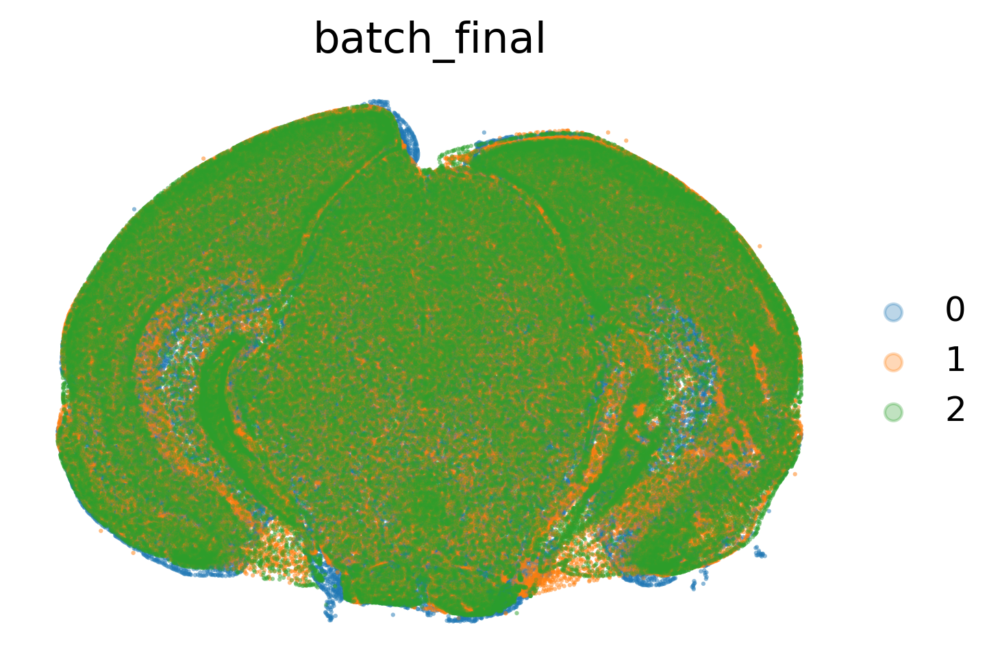

In [187]:
sq.pl.spatial_scatter(
    adata,
    spatial_key="spatial_norm_final",
    shape=None,
    color="batch_final",
    frameon=False,
    size=1,
    alpha=0.3,
    figsize=(5, 5),
    dpi=300,
)
plt.tight_layout()

In [ ]:
adata_final.write("adata_full_FGW_RUN_ALIGNED_MINMAX_FINAL.h5ad")

In [111]:
sc.pp.highly_variable_genes(adata)

In [116]:
adata.var_names[adata.var["highly_variable"]].tolist()

['Adgre1',
 'Adgrf5',
 'Adgrl4',
 'Adgrg6',
 'Ccr1',
 'Ccr2',
 'Cxcr4',
 'C3ar1',
 'C5ar1',
 'Cnr1',
 'Cmklr1',
 'Cx3cr1',
 'Drd2',
 'Fshr',
 'Fzd2',
 'Gper1',
 'Gpr182',
 'Gpr183',
 'Gpr20',
 'Gpr37l1',
 'Gprc5c',
 'Gabbr1',
 'Grpr',
 'Glp1r',
 'Glp2r',
 'Hcar1',
 'Oprk1',
 'Gpr50',
 'Chrm5',
 'Nmbr',
 'Tacr3',
 'Npsr1',
 'Npy2r',
 'P2ry12',
 'P2yr13',
 'P2ry14',
 'P2ry6',
 'Pth2r',
 'Pth1r',
 'Gpr101',
 'Gpr139',
 'Gpr34',
 'Prokr2',
 'Ptgdr',
 'Qrfpr',
 'Rxfp2',
 'S1pr3',
 'S1pr5',
 'Tbxa2r',
 'Gpr17',
 'Vipr2',
 'Vmn1r40',
 'Cspg5',
 'Mki67',
 'Gjc3',
 'Olig1',
 'Gad1',
 'Slc17a6',
 'Slc17a7',
 'Slc17a8',
 'Aqp4',
 'Slc15a3',
 'Selplg',
 'Slco1a4',
 'Fn1',
 'Cldn5',
 'Emcn',
 'Myh11',
 'Lmod1',
 'Atp13a5',
 'Kcnj8',
 'Abcc9',
 'Cd300c2',
 'C1qa',
 'C1qb',
 'Cxcl12',
 'Dlk1',
 'Peg10',
 'Chat',
 'Cx3cl1',
 'Igfbpl1',
 'Eomes',
 'Th',
 'Top2a',
 'Gfap',
 'Slc47a1',
 'Pln',
 'Csf1r',
 'Ddr2',
 'Efemp1',
 'Fgfr3',
 'Flt1',
 'Insrr',
 'Kdr',
 'Mertk',
 'Musk',
 'Ntrk1',
 'Pdgfra',
 'Pdg

In [31]:
[i["coords"] for i in res if i is not None]

[array([0.05555556, 0.12695505]),
 array([0.05555556, 0.20474596]),
 array([0.05555556, 0.28253687]),
 array([0.05555556, 0.36032777]),
 array([0.05555556, 0.43811868]),
 array([0.05555556, 0.51590959]),
 array([0.05555556, 0.59370049]),
 array([0.16666667, 0.04916414]),
 array([0.16666667, 0.12695505]),
 array([0.16666667, 0.20474596]),
 array([0.16666667, 0.28253687]),
 array([0.16666667, 0.36032777]),
 array([0.16666667, 0.43811868]),
 array([0.16666667, 0.51590959]),
 array([0.16666667, 0.59370049]),
 array([0.16666667, 0.6714914 ]),
 array([0.27777778, 0.04916414]),
 array([0.27777778, 0.12695505]),
 array([0.27777778, 0.20474596]),
 array([0.27777778, 0.28253687]),
 array([0.27777778, 0.36032777]),
 array([0.27777778, 0.43811868]),
 array([0.27777778, 0.51590959]),
 array([0.27777778, 0.59370049]),
 array([0.27777778, 0.6714914 ]),
 array([0.38888889, 0.04916414]),
 array([0.38888889, 0.12695505]),
 array([0.38888889, 0.20474596]),
 array([0.38888889, 0.28253687]),
 array([0.3888

In [151]:
bin_counts = []
nbin_counts = []
for x_min, x_max in pairwise(xv):
    for y_min, y_max in pairwise(yv):
        cond = (
            (x_min < arr[:, 0])
            & (arr[:, 0] <= x_max)
            & (y_min < arr[:, 1])
            & (arr[:, 1] <= y_max)
        )
        if sum(cond):
            nbin_counts.append(sum(cond))
            bin_counts.append(np.array(adata[cond].X.sum(0)).squeeze())

In [152]:
from anndata import AnnData

binned_adata = AnnData(np.vstack(bin_counts), obs={"nbins": nbin_counts})

array([[0.0000000e+00, 7.6063740e-01, 4.5014483e-01, ..., 1.1906615e+00,
        0.0000000e+00, 0.0000000e+00],
       [2.7406208e+01, 2.5983521e+02, 2.6523734e+02, ..., 3.4036673e+02,
        2.0987894e+02, 2.3240144e+03],
       [8.1511177e+01, 5.4507550e+02, 6.7624567e+02, ..., 5.4934790e+02,
        4.5778873e+02, 5.0185332e+03],
       ...,
       [4.8774937e+01, 3.3435202e+02, 4.5631812e+02, ..., 5.9374219e+02,
        4.7304218e+02, 3.3716965e+03],
       [4.3713055e+01, 3.4768991e+02, 2.4129160e+02, ..., 4.2595718e+02,
        3.2520312e+02, 2.4120752e+03],
       [9.9896336e+00, 1.0757872e+02, 3.7390137e+01, ..., 1.3832347e+02,
        1.0019283e+02, 5.9308203e+02]], dtype=float32)

<AxesSubplot: xlabel='nbins', ylabel='Count'>

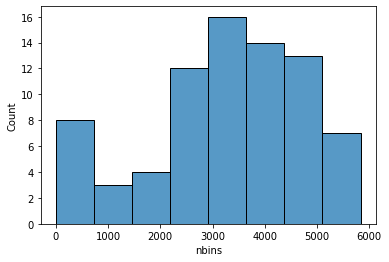

In [155]:
sns.histplot(binned_adata.obs.nbins)

In [116]:
binned_adata.obs.nbins

0     0
1     0
2     0
3     0
4     0
     ..
94    0
95    0
96    0
97    0
98    0
Name: nbins, Length: 99, dtype: int64

In [ ]:
interactions = np.ma.masked_where((pval < 1e-3) & (means > 1), means).mask.sum(0)

In [70]:
idx, vx = np.histogram(adata.obsm["spatial_norm"][:, 0], bins=10)
idy, vy = np.histogram(adata.obsm["spatial_norm"][:, 1], bins=10)

In [73]:
vx

array([-2.04421309, -1.60417865, -1.16414421, -0.72410977, -0.28407533,
        0.1559591 ,  0.59599354,  1.03602798,  1.47606242,  1.91609686,
        2.3561313 ])

In [79]:
arr_x = adata.obsm["spatial_norm"][:, 0]
for x in pairwise(vx):
    # for y in pairwise(vy):
    # np.where(x[0] < arr_x <= x[1], arr_x))

-2.044213086131767
-1.6041786479363584
-1.1641442097409498
-0.7241097715455411
-0.28407533335013246
0.1559591048452762
0.5959935430406849
1.0360279812360935
1.4760624194315022
1.9160968576269108


In [63]:
vx

array([-2.04421309, -2.00020964, -1.9562062 , -1.91220275, -1.86819931,
       -1.82419587, -1.78019242, -1.73618898, -1.69218554, -1.64818209,
       -1.60417865, -1.5601752 , -1.51617176, -1.47216832, -1.42816487,
       -1.38416143, -1.34015799, -1.29615454, -1.2521511 , -1.20814765,
       -1.16414421, -1.12014077, -1.07613732, -1.03213388, -0.98813043,
       -0.94412699, -0.90012355, -0.8561201 , -0.81211666, -0.76811322,
       -0.72410977, -0.68010633, -0.63610288, -0.59209944, -0.548096  ,
       -0.50409255, -0.46008911, -0.41608566, -0.37208222, -0.32807878,
       -0.28407533, -0.24007189, -0.19606845, -0.152065  , -0.10806156,
       -0.06405811, -0.02005467,  0.02394877,  0.06795222,  0.11195566,
        0.1559591 ,  0.19996255,  0.24396599,  0.28796944,  0.33197288,
        0.37597632,  0.41997977,  0.46398321,  0.50798666,  0.5519901 ,
        0.59599354,  0.63999699,  0.68400043,  0.72800387,  0.77200732,
        0.81601076,  0.86001421,  0.90401765,  0.94802109,  0.99

In [48]:
np.floor(np.mgrid[vx, vy][0] / 50)

AttributeError: 'numpy.ndarray' object has no attribute 'step'

In [36]:
np.floor(np.mgrid[0:nx, 0:ny][1] / 50)

array([[0., 0.],
       [0., 0.],
       [0., 0.],
       ...,
       [0., 0.],
       [0., 0.],
       [0., 0.]])

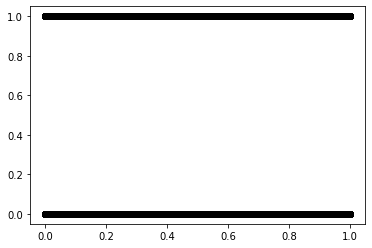

In [33]:
import matplotlib.pyplot as plt

plt.plot(xv, yv, marker="o", color="k", linestyle="none")
plt.show()

In [20]:
x = adata[adata.obs.batch_final == 0].obsm["spatial_norm"][:, 0].copy()
y = adata[adata.obs.batch_final == 0].obsm["spatial_norm"][:, 1].copy()
zi, yi, xi = np.histogram2d(y, x, bins=(10, 10), normed=False)
counts, _, _ = np.histogram2d(y, x, bins=(10, 10))

zi = zi / counts
zi = np.ma.masked_invalid(zi)

/tmp/ipykernel_77685/56234770.py:6: RuntimeWarning: invalid value encountered in true_divide
  zi = zi / counts


In [22]:
counts

array([[0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0.]])

In [3]:
slice_1 = ["1_1", "1_2", "1_3"]
slice_2 = ["2_1", "2_2", "2_3"]
slice_3 = ["3_1", "3_2", "3_3"]

In [4]:
adata = adata[adata.obs.batch.isin(slice_1)].copy()

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


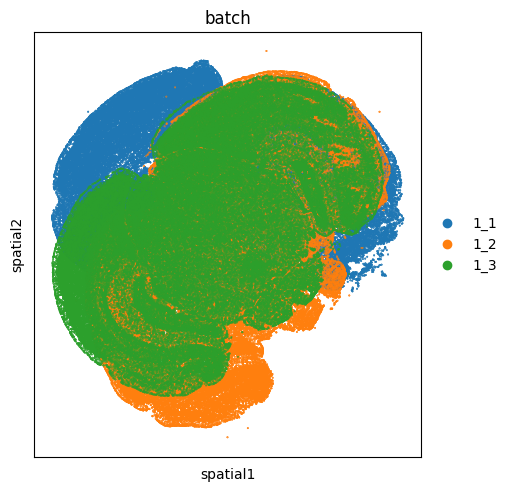

In [5]:
sq.pl.spatial_scatter(adata, shape=None, color="batch")

In [6]:
import moscot as mt

ap = (
    mt.problems.space.AlignmentProblem(adata)
    .prepare(batch_key="batch")
    .solve(
        rank=500,
        max_iterations=200,
        threshold=1e-7,
        epsilon=1e-3,
        alpha=0.5,
        linear_solver_kwargs={
            "epsilon": 1e-3,
            "max_iterations": 200,
            "threshold": 1e-5,
        },
    )
)

INFO     Normalizing spatial coordinates and saving them in `adata.obsm['spatial_norm']`.                          
INFO     Computing pca with `n_comps=30` for `xy` using `adata.X`                                                  
INFO     Computing pca with `n_comps=30` for `xy` using `adata.X`                                                  
INFO     Solving problem OTProblem[stage='prepared', shape=(78329, 88884)].                                        
WARNING  Solver did not converge                                                                                   
INFO     Solving problem OTProblem[stage='prepared', shape=(88884, 84636)].                                        
WARNING  Solver did not converge                                                                                   


In [7]:
ap

AlignmentProblem[('1_1', '1_2'), ('1_2', '1_3')]

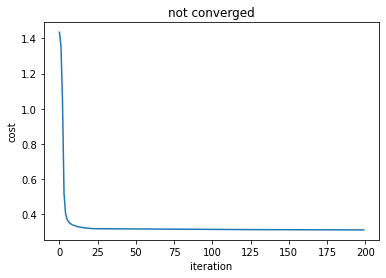

In [8]:
ap[("1_2", "1_3")].solution.plot_convergence()

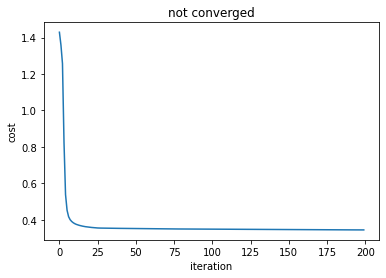

In [9]:
ap[("1_1", "1_2")].solution.plot_convergence()

In [10]:
ap.align(reference="1_1", mode="warp")
ap.align(reference="1_1", mode="affine")

In [11]:
ap.spatial_key

'spatial_norm'

In [12]:
adata1_2 = adata[adata.obs.batch.isin(["1_1", "1_2"])].copy()
adata1_3 = adata[adata.obs.batch.isin(["1_1", "1_3"])].copy()

In [13]:
ap[("1_1", "1_2")].solution.to("cpu")

OTTOutput[shape=(78329, 88884), cost=0.3443, converged=False]

In [14]:
ap[("1_2", "1_3")].solution.to("cpu")

OTTOutput[shape=(88884, 84636), cost=0.3101, converged=False]

In [15]:
ap.adata.write(root / "adata_full_FGW_RUN.h5ad")

In [6]:
adata = sc.read(root / "adata_full_FGW_RUN.h5ad")

In [7]:
adata1_2 = adata[adata.obs.batch.isin(["1_1", "1_2"])].copy()
adata1_3 = adata[adata.obs.batch.isin(["1_1", "1_3"])].copy()

In [8]:
from moscot.problems.generic import SinkhornProblem

sp1_2 = (
    SinkhornProblem(adata=adata1_2)
    .prepare(
        key="batch",
        joint_attr={"attr": "obsm", "key": "spatial_norm_affine"},
    )
    .solve(epsilon=1e-2, threshold=1e-5, batch_size=10_000)
)

INFO     Solving problem OTProblem[stage='prepared', shape=(78329, 88884)].                                        


In [ ]:
sp1_3 = (
    SinkhornProblem(adata=adata1_3)
    .prepare(
        key="batch",
        joint_attr={"attr": "obsm", "key": "spatial_norm_affine"},
    )
    .solve(epsilon=1e-2, threshold=1e-5, batch_size=10_000)
)

INFO     Solving problem OTProblem[stage='prepared', shape=(78329, 84636)].                                        


In [10]:
adata1 = adata1_2[adata1_2.obs.batch.isin(["1_1"])].copy()
adata2 = adata1_2[adata1_2.obs.batch.isin(["1_2"])].copy()
adata3 = adata1_3[adata1_3.obs.batch.isin(["1_3"])].copy()

spatial2 = (
    sp1_2[("1_1", "1_2")]
    .solution.to("cpu")
    .push(adata1.obsm["spatial_norm"], scale_by_marginals=True)
)
spatial3 = (
    sp1_3[("1_1", "1_3")]
    .solution.to("cpu")
    .push(adata1.obsm["spatial_norm"], scale_by_marginals=True)
)

In [12]:
print(adata1.shape, spatial2.shape, spatial3.shape)

(78329, 483) (88884, 2) (84636, 2)


In [14]:
spatial1 = adata1.obsm["spatial_norm"].copy()
min_ = spatial1.min()
max_ = spatial1.max()

In [22]:
adata1.obsm["spatial_norm_final"] = (
    adata1.obsm["spatial_norm"].copy() - spatial1.min()
) / (spatial1.max() - spatial1.min())
adata2.obsm["spatial_norm_final"] = (spatial2 - spatial2.min()) / (
    spatial2.max() - spatial2.min()
)
adata3.obsm["spatial_norm_final"] = (spatial3 - spatial3.min()) / (
    spatial3.max() - spatial3.min()
)

In [23]:
adata_final = ad.concat(
    [adata1, adata2, adata3], label="batch_final", keys=["0", "1", "2"]
)

/home/icb/giovanni.palla/code/squidpy/squidpy/pl/_spatial_utils.py:955: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  _cax = scatter(


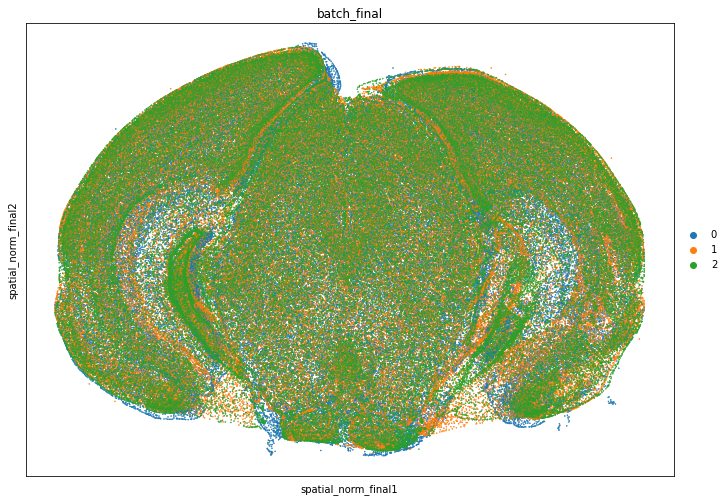

In [24]:
sq.pl.spatial_scatter(
    adata_final,
    shape=None,
    color="batch_final",
    spatial_key="spatial_norm_final",
    figsize=(10, 10),
)

In [26]:
adata_final.write(root / "adata_full_FGW_RUN_ALIGNED_MINMAX.h5ad")